# CM3005 Data Science Midterm Coursework

## Introduction 

### 1. Domain-specific area
Because of its major effects on important sectors and fields such as building, investment, and public welfare, the real estate industry has been one of the leading researches focused on modern economics. Nowadays, a lot of individuals invest in real estate since it can occasionally generate a lot of capital income, which has caused some countries to experience a highly violent development. In some ways, real estate investment can be seen as a reflection of the state of local real estate development. For instance, if investment is brisk, this indicates that supply is insufficient and that development is imbalanced. The recent real estate market is pretty stable if investment is chilly. Additionally, it is an indication of how a city is growing.

However, this does not imply that the greater the investment, the better the real estate will develop or the greater the advantages to the investors. There may be adverse circumstances, and some locations have already experienced this. Additionally, real estate investment has failed in many locations, outpacing demand. This is a waste of resources and irresponsible with regard to people's lives. Additionally, there may be instances where workers are not paid, which will lead to social unrest. Controlling real estate investment is crucial to avoiding these scenarios, so that they don't arise.

### 2. Dataset

The dataset I am using is Comma Separated Values(CSV). I'm concentrating more on taxi, market and hospital distances again from price house for this project. I will be dropping 'Parking_type', 'City_type', 'Carpet_area', 'Rainfall', 'Builtup_area' these datasets. I want to discover out that if factors like the distance to the market, the hospital, and the taxi stand have a big influence on the amount a house costs.

The datasets has 932 entries which entries start from 0 and end with 931. The dataset has 9 columns which are shown below

####  9 columns | datatypes:
- Taxi_dist (float 64)
- Market_dist (float 64)
- Hospital_dist (float 64)
- Carpet_area (float 64)
- Builtup_area (float 64)
- Parking_type (objects)
- City_type (objects)
- Rainfall (int64)
- Price_house (int64)

Some datatype has null values such as:
- Taxi_dist 
- Market_dist
- Hospital_dist
- Carpet_area 
- Builtup_area.

I will start using the pandas dataframe.desscribe( ) function to look at the overall of the statistic of the data. Next, determining whether the datasets contain any null values. If any null values exist in the data I use later, the median value will be used to fill in all of the null values since I am only using distance datasets from the taxi, market, and hospital. Because there are some numbers that are very disconnected from the testing data, I did not chose the mean and mode values. As a result, using the mean value to fill in the null values are not particularly accurate. In addition, the price of the house is not uniform, I decided against using mode value. The datasize of this dataset is approximately 51kb.

In addition, since the datas I am using are floats and integers, I do not need to change the datatype. Then I will start to visualize data and do the regression. 

 The data were acquired from the kaggle:

<i>House-Price-Sales-Predication, the collaborators is Kavita Lolayekar (Owner). The dataset can be accessed via the Kaggle official website. The link is <a href ='https://www.kaggle.com/datasets/kavita5/housepricesalespredication'>here</ahref> </i>

### 3. Objectives of the project

The project's goal is to determine whether the distance between the market, the hospital, and the service station has a significant impact on the price of housing. The price of the housing may be influenced by factors such as transportation, groceries, and healthcare.

Time is valuable in today's fast-paced society, so individuals consider buying a home if it will cut down on the amount of time it takes them to drive to work, shop for food, or even go to the doctor. When hurrying to work, some individuals prefer to stay in locations where they can conveniently obtain a taxi. Alternatively, some people prefer to stay a little closer to the hospital because they do not want to travel very far, while others prefer to stay a little further away because of the ambulance's siren.

As for me, I wouldn't mind paying a little bit more for a house if the markets and taxis were conveniently located. When I'm hurrying to work, I do not wish to squander too much time waiting for a taxi or traveling far enough to the market. Since the market and taxi distance have a significant impact on my everyday life than the hospital, I would argue that it is less crucial to have easy access to the hospital.

In attempt to assist those who are considering purchasing a home, I hope to create a model that can predict the price of a house in relation to these three parameters. I'll attempt to compare the estimated and actual values of the house.


In [37]:
# Import necessary data
import numpy as np
import pandas as pd
import math
import scipy.stats as stats
from scipy.stats import norm

# Data Visualisation
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Supress Warnings
import warnings 
warnings.filterwarnings('ignore')

# Scikit Library
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures,StandardScaler
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score, mean_absolute_error

SyntaxError: invalid syntax (3989825263.py, line 13)

In [2]:
# Import csv file
df = pd.read_csv('data.csv')
df.head()

,Taxi_dist,Market_dist,Hospital_dist,Carpet_area,Builtup_area,Parking_type,City_type,Rainfall,Price_house
0,9796.0,5250.0,10703.0,1659.0,1961.0,Open,CAT B,530,6649000
1,8294.0,8186.0,12694.0,1461.0,1752.0,Not Provided,CAT B,210,3982000
2,11001.0,14399.0,16991.0,1340.0,1609.0,Not Provided,CAT A,720,5401000
3,8301.0,11188.0,12289.0,1451.0,1748.0,Covered,CAT B,620,5373000
4,10510.0,12629.0,13921.0,1770.0,2111.0,Not Provided,CAT B,450,4662000


### Data Inspection

In [3]:
# Understand the information, data type of the data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 932 entries, 0 to 931
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Taxi_dist      919 non-null    float64
 1   Market_dist    919 non-null    float64
 2   Hospital_dist  931 non-null    float64
 3   Carpet_area    924 non-null    float64
 4   Builtup_area   917 non-null    float64
 5   Parking_type   932 non-null    object 
 6   City_type      932 non-null    object 
 7   Rainfall       932 non-null    int64  
 8   Price_house    932 non-null    int64  
dtypes: float64(5), int64(2), object(2)
memory usage: 65.7+ KB


In [4]:
# Drop unncessary columns
df.drop(['Parking_type', 'City_type', 'Carpet_area', 'Rainfall', 'Builtup_area'], axis=1, inplace=True)
df

,Taxi_dist,Market_dist,Hospital_dist,Price_house
0,9796.0,5250.0,10703.0,6649000
1,8294.0,8186.0,12694.0,3982000
2,11001.0,14399.0,16991.0,5401000
3,8301.0,11188.0,12289.0,5373000
4,10510.0,12629.0,13921.0,4662000
...,...,...,...,...
927,12176.0,8518.0,15673.0,6639000
928,7214.0,8717.0,10553.0,8208000
929,7423.0,11708.0,13220.0,7644000
930,15082.0,14700.0,19617.0,9661000


In [5]:
# Find the sum of null values in each columns
df.isnull().sum()

Taxi_dist        13
Market_dist      13
Hospital_dist     1
Price_house       0
dtype: int64

### Can use df.describe( ) to get the staistic summary of the data

In [6]:
# Look at the statistic values of each columns 
df.describe()

,Taxi_dist,Market_dist,Hospital_dist,Price_house
count,919.000000,919.000000,931.000000,9.320000e+02
mean,8229.727965,11018.752992,13072.092374,6.084695e+06
std,2561.985008,2543.920590,2586.456161,5.025364e+06
min,146.000000,1666.000000,3227.000000,3.000000e+04
25%,6476.000000,9354.500000,11301.500000,4.658000e+06
50%,8230.000000,11161.000000,13163.000000,5.866000e+06
75%,9937.000000,12670.500000,14817.000000,7.187250e+06
max,20662.000000,20945.000000,23294.000000,1.500000e+08


In [7]:
# fill na with median value 
df = df.fillna(df.median())

In [8]:
# Ensure the  data has no null values
df.isnull().sum()

Taxi_dist        0
Market_dist      0
Hospital_dist    0
Price_house      0
dtype: int64

# Key series of the dataset and provide statistical summary of the data

array([[<AxesSubplot:title={'center':'Taxi_dist'}>,
        <AxesSubplot:title={'center':'Market_dist'}>],
       [<AxesSubplot:title={'center':'Hospital_dist'}>,
        <AxesSubplot:title={'center':'Price_house'}>]], dtype=object)

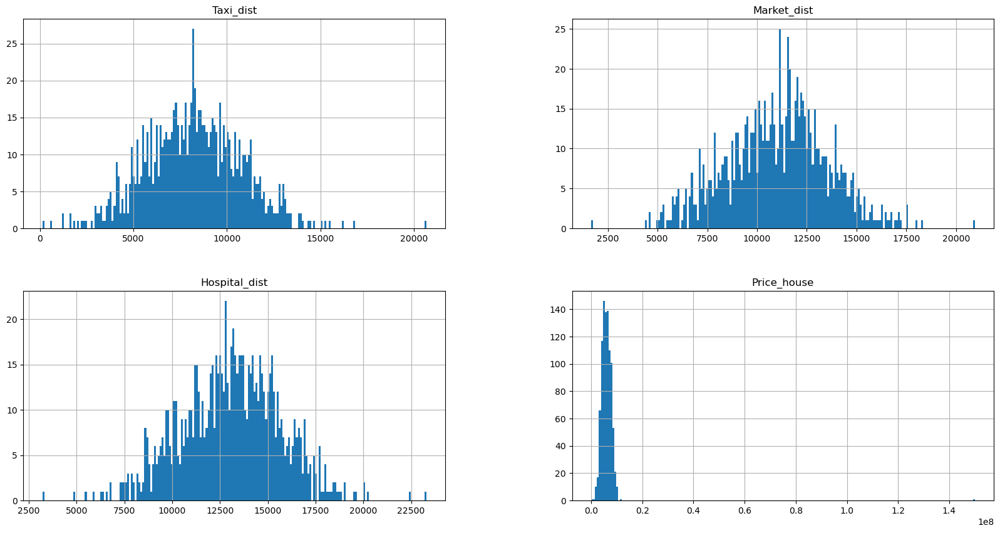

In [9]:
# plot histogram of each columns to overlook the data
df.hist(bins=200, figsize=[20,10])

## Use boxplot to find the outliers of the data

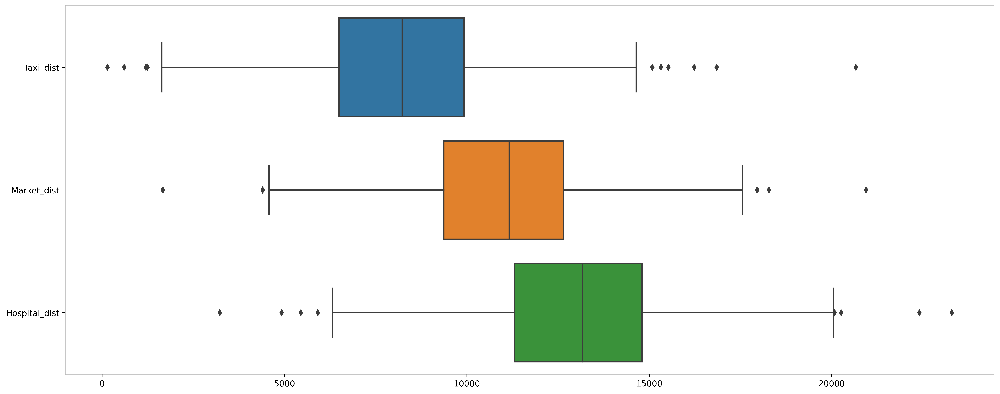

In [10]:
# Plot a boxplot of 'Taxi_dist', 'Market_dist', 'Hospital_dist' to find the outliers
plt.figure(figsize=(20,8),dpi=400)
sns.boxplot(data=df[[ 'Taxi_dist', 'Market_dist', 'Hospital_dist']], orient='h') # Orientation of the plot is vertical
plt.show()

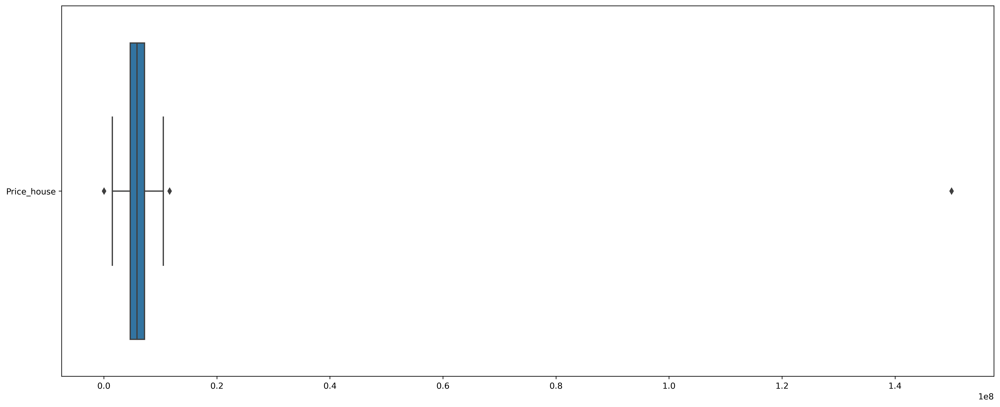

In [11]:
# Plot a boxplot to find the outliers of 'Price_house' 
plt.figure(figsize=(20,8),dpi=400)
sns.boxplot(data=df[[ 'Price_house']],orient='h') # Orientation of the plot is horizontal
plt.show()

## Remove outliers using Winsorizer
### Choose Interquartiles range (IQR) rule boundaries as the main method

In [12]:
# import Winsorizer from feature_engine.outliers
from feature_engine.outliers import Winsorizer

# Remove outliers of 'Price_house'
winsor = Winsorizer(capping_method='iqr', # choose  IQR rule boundaries or gaussian for mean and std
                          tail='both', # cap left, right or both tails 
                          fold=1.5,
                          variables=['Price_house'])

df['Price_house'] = winsor.fit_transform(df[['Price_house']])


# Remove outliers of 'Taxi_dist'
winsor = Winsorizer(capping_method='iqr', # choose  IQR rule boundaries or gaussian for mean and std
                          tail='both', # cap left, right or both tails 
                          fold=1.5,
                          variables=['Taxi_dist'])

df['Taxi_dist'] = winsor.fit_transform(df[['Taxi_dist']])


# Remove outliers of 'Market_dist'
winsor = Winsorizer(capping_method='iqr', # choose  IQR rule boundaries or gaussian for mean and std
                          tail='both', # cap left, right or both tails 
                          fold=1.5,
                          variables=['Market_dist'])

df['Market_dist'] = winsor.fit_transform(df[['Market_dist']])


# Remove outliers of 'Hospital_dist'
winsor = Winsorizer(capping_method='iqr', # choose  IQR rule boundaries or gaussian for mean and std
                          tail='both', # cap left, right or both tails 
                          fold=1.5,
                          variables=['Hospital_dist'])

df['Hospital_dist'] = winsor.fit_transform(df[['Hospital_dist']])

## Plot boxplot again to ensure that all the outliers are not in the dataset 

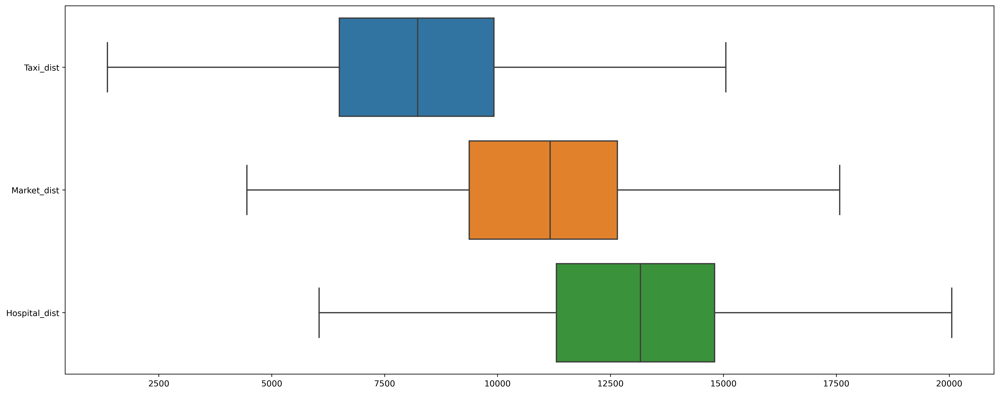

In [13]:
# Plot a boxplot of 'Taxi_dist', 'Market_dist', 'Hospital_dist' 
plt.figure(figsize=(20,8),dpi=400)
sns.boxplot(data=df[[ 'Taxi_dist', 'Market_dist','Hospital_dist']],orient='h') # Orientation of the plot is horizontal
plt.show()

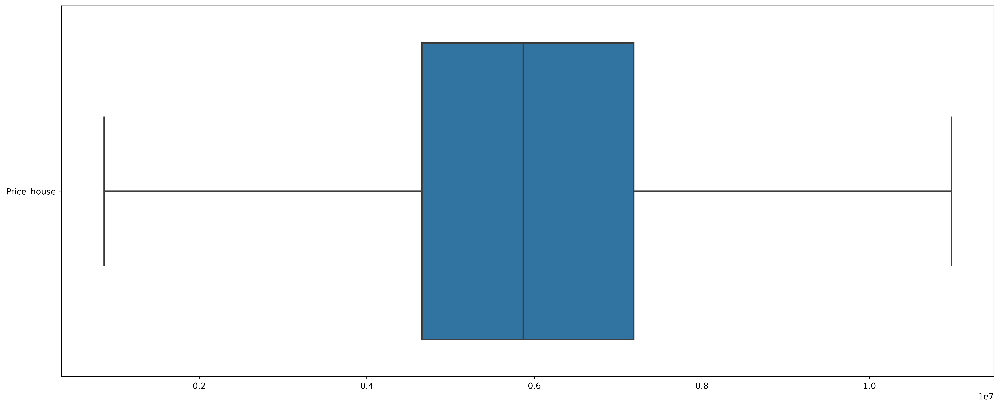

In [14]:
# Plot a boxplot of 'Price_house' to ensure outliers are gone
plt.figure(figsize=(20,8),dpi=400)
sns.boxplot(data=df[[ 'Price_house']], orient='h') # Orientation of the plot is horizontal
plt.show()

## Find the central tendency and distribution of Price_house

The mean value of Price_house:  5935730.016094421
The median value of Price_house:  5866000.0
The mode value of Price_house:  5459000.0


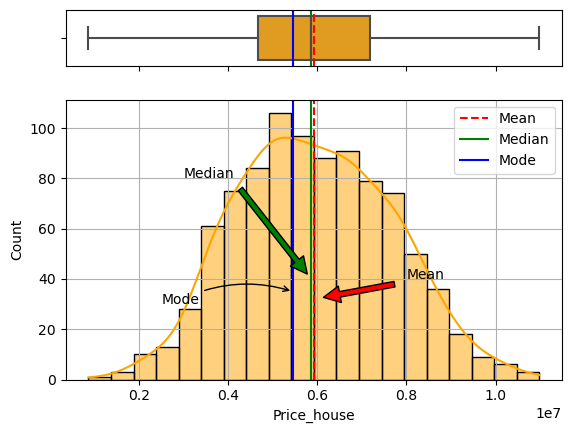

In [15]:
# Create a figure o and an array of axes objects
# The shape of the axes array 
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw= {"height_ratios": (0.2, 1)})
mean = df['Price_house'].mean() # Find the mean value
median = df['Price_house'].median() #Find the median value
mode = df['Price_house'].mode().values[0] # Find the mode value

# print the mean, median and mode value
print("The mean value of Price_house: ", mean)
print("The median value of Price_house: ", median)
print("The mode value of Price_house: ", mode)

# plot the boxplot
sns.boxplot(x=df["Price_house"], color='orange', ax=ax_box) 
ax_box.axvline(mean, color='r', linestyle='--') # mean line
ax_box.axvline(median, color='g', linestyle='-') #median line
ax_box.axvline(mode, color='b', linestyle='-') #mode line

#plot the hist
sns.histplot(x=df["Price_house"], ax=ax_hist, color='orange', edgecolor='k', kde=True)
ax_hist.axvline(mean, color='r', linestyle='--', label="Mean") # mean line
ax_hist.axvline(median, color='g', linestyle='-', label="Median")# median line
ax_hist.axvline(mode, color='b', linestyle='-', label="Mode") # mode line


# Add labels to the plot
# Mean label
ax_hist.annotate('Mean', xy=(0.593e+7, 32), xytext=(0.8e+7, 40),
                 arrowprops=dict(facecolor='red', shrink=0.1))

# Median label
ax_hist.annotate('Median', xy=(0.586e+7, 40), xytext=(0.3e+7, 80),
                 arrowprops=dict(facecolor='green', shrink=0.05))

# Model abel
ax_hist.annotate('Mode', xy=(0.545e+7, 35), xytext=(0.25e+7, 30),
                 arrowprops=dict(arrowstyle="->",
                            connectionstyle="arc3,rad=-0.2"))

# Apply legend
ax_hist.legend()
ax_box.set(xlabel='')

# Show the graph
plt.grid(True)
plt.show()

# Visualize key data series within the dataset

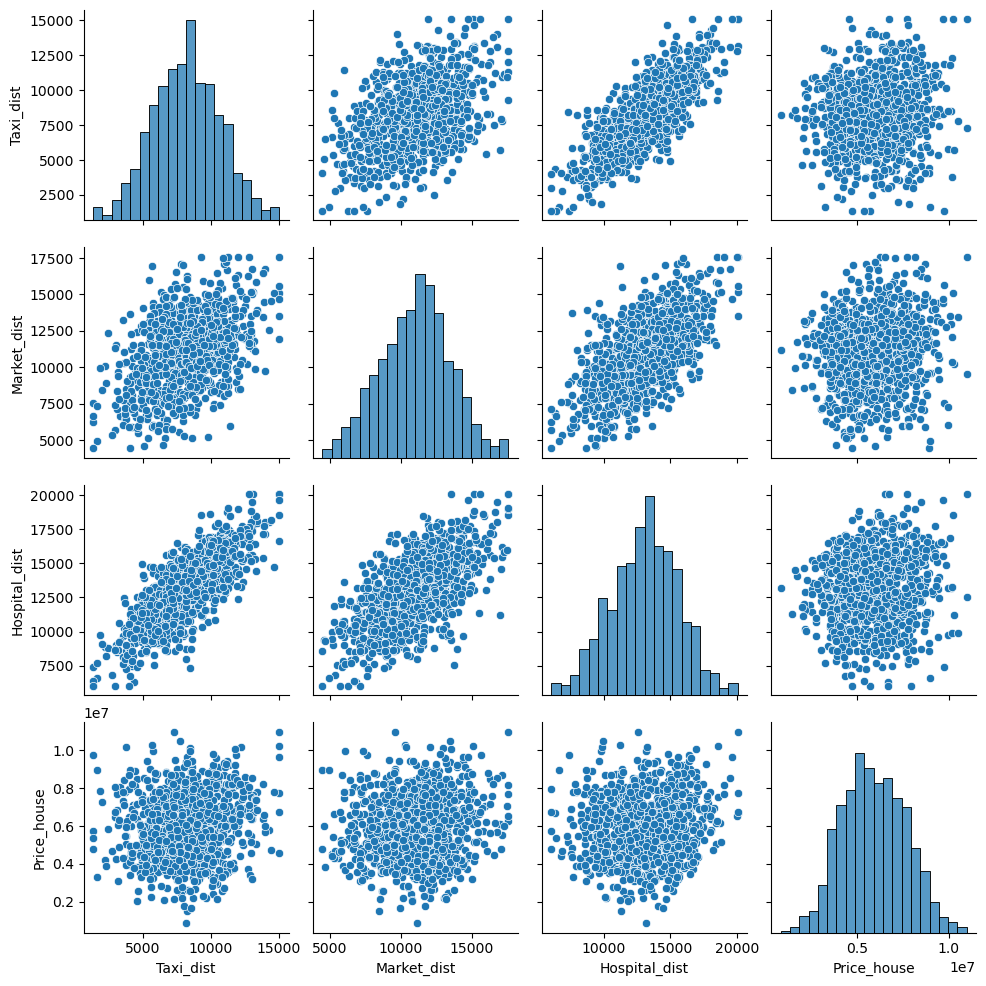

In [16]:
# Use sns pairplot to visualize key data series and the distribution of the data
sns.pairplot(df)

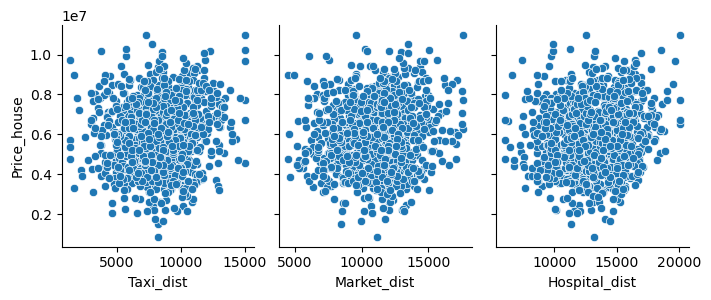

In [17]:
# Find the connection between the distance of each variables against price of the house
sns.pairplot(df, x_vars=['Taxi_dist', 'Market_dist', 'Hospital_dist'], 
             y_vars='Price_house',
             height= 3, 
             aspect=0.8, 
             kind='scatter')

<AxesSubplot:xlabel='Price_house', ylabel='Density'>

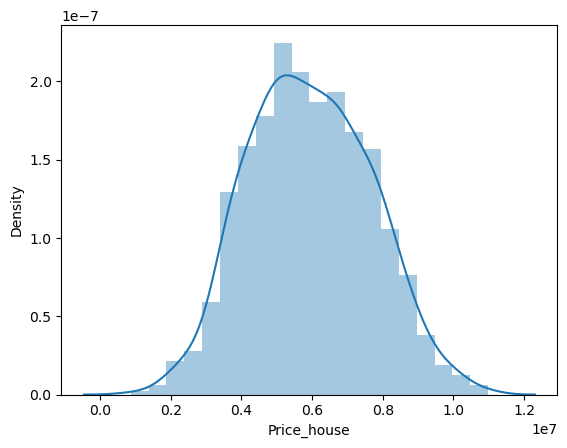

In [18]:
sns.distplot(df.Price_house)

Text(0.5, 1.0, 'Correlation Variables in heatmap')

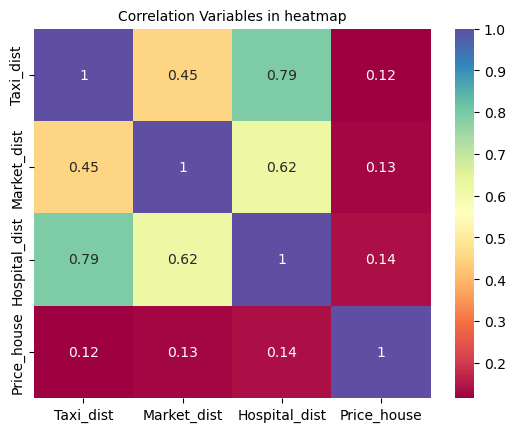

In [19]:
# Use a heatmap to understand the correlation
sns.heatmap(df.corr(),annot=True, cmap='Spectral').set_title('Correlation Variables in heatmap', size='10')

In [20]:
# Sort correlation values to 
df.corr().Price_house.sort_values(ascending=False)

Price_house      1.000000
Hospital_dist    0.137566
Market_dist      0.125183
Taxi_dist        0.115549
Name: Price_house, dtype: float64

## Use dataprep.eda to create report and have a better understanding of the data

  0%|                                                   | 0/803 [00:00<?, ?it/s]

DataPrep Report
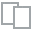
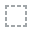
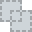
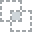
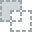
...
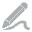
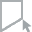
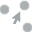
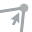
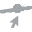

In [21]:
from dataprep.eda import create_report
create_report(df)

## Install autoviz lib to have better visualise of the data

In [22]:
# Convert the current csv to new csv
df.to_csv('new_data.csv')

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
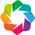

Imported v0.1.58. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine
Shape of your Data Set loaded: (932, 5)
#######################################################################################
######################## C L A S S I 

,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
Unnamed: 0,932,int64,0,0.000000,100.000000,0,possible ID column: drop
Hospital_dist,889,float64,0,0.000000,95.386266,0,
Taxi_dist,876,float64,0,0.000000,93.991416,0,
Market_dist,863,float64,0,0.000000,92.596567,0,
Price_house,848,float64,0,0.000000,90.987124,0,


  Printing upto 30 columns max in each category:
    Numeric Columns : ['Taxi_dist', 'Market_dist', 'Hospital_dist', 'Price_house']
    Integer-Categorical Columns: []
    String-Categorical Columns: []
    Factor-Categorical Columns: []
    String-Boolean Columns: []
    Numeric-Boolean Columns: []
    Discrete String Columns: []
    NLP text Columns: []
    Date Time Columns: []
    ID Columns: ['Unnamed: 0']
    Columns that will not be considered in modeling: []
    5 Predictors classified...
        1 variables removed since they were ID or low-information variables
        List of variables removed: ['Unnamed: 0']
   Columns to delete:
'   []'
   Boolean variables %s 
'   []'
   Categorical variables %s 
'   []'
   Continuous variables %s 
"   ['Taxi_dist', 'Market_dist', 'Hospital_dist', 'Price_house']"
   Discrete string variables %s 
'   []'
   Date and time variables %s 
'   []'
   ID variables %s 
"   ['Unnamed: 0']"
   Target variable %s 
'   '
Number of All Scatter Plots =

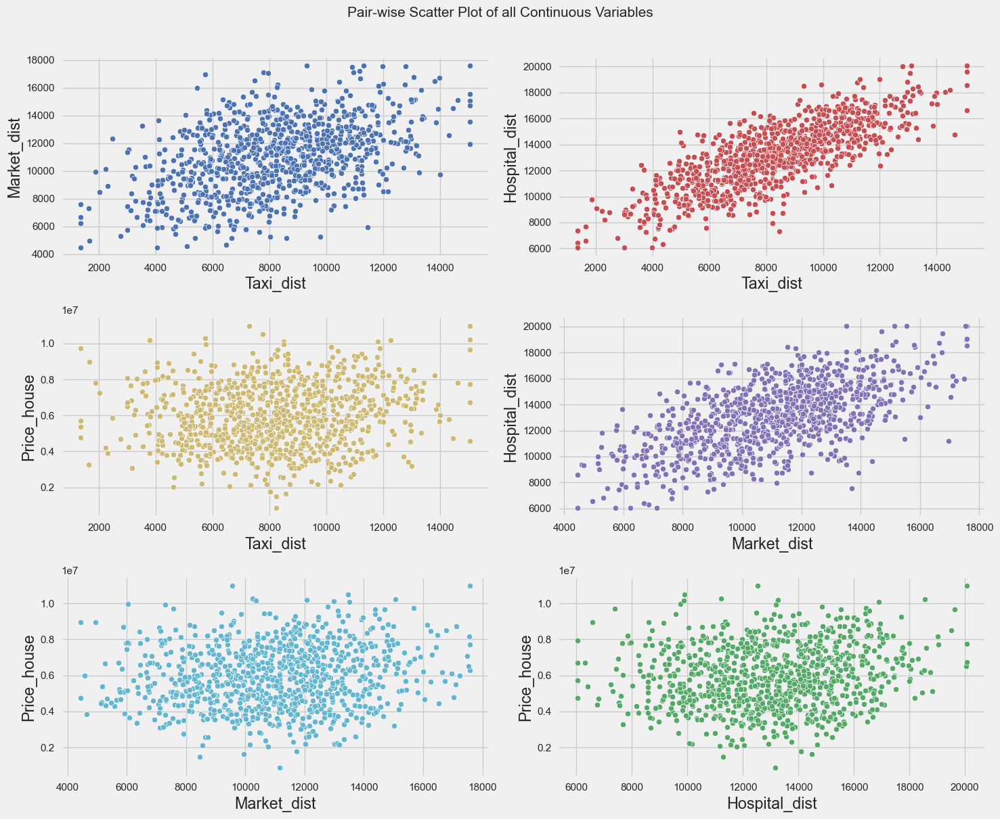

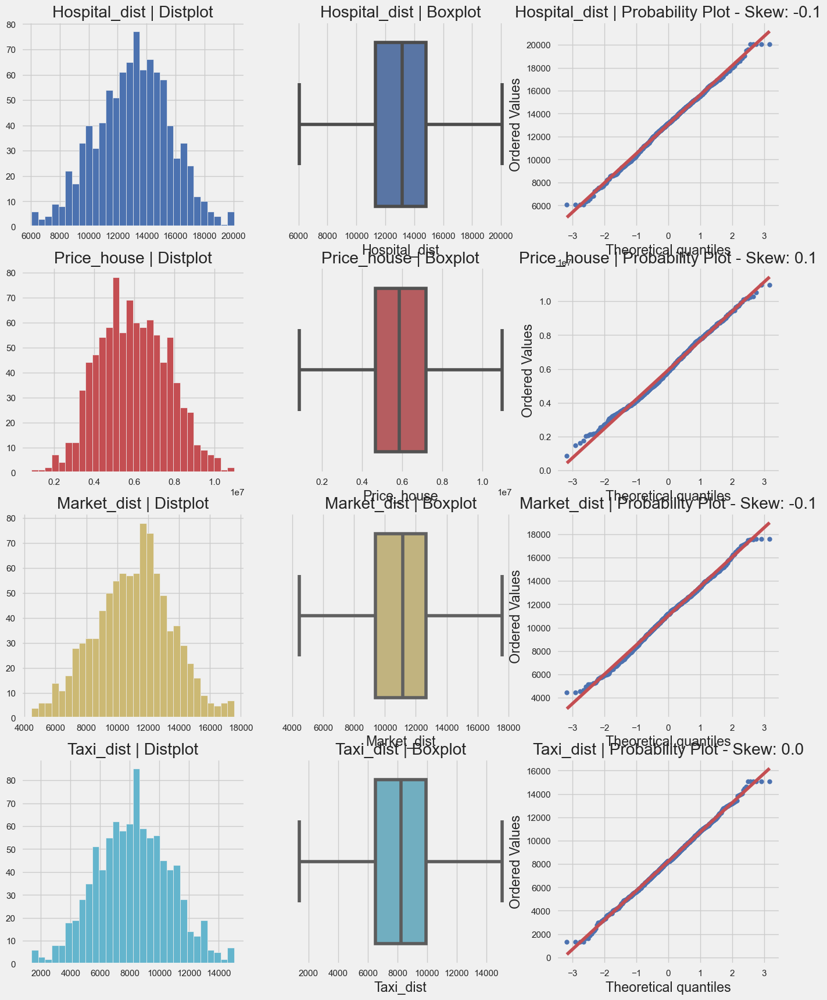

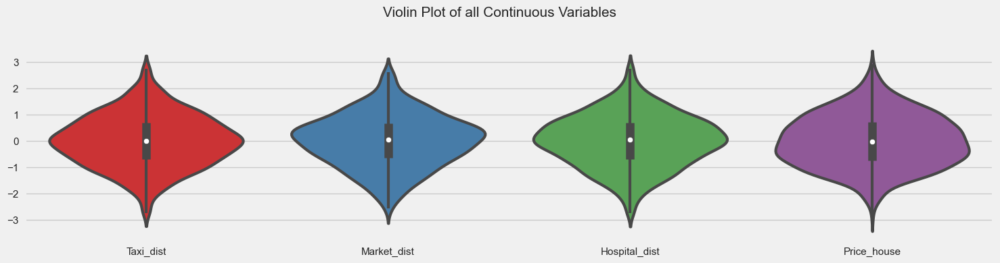

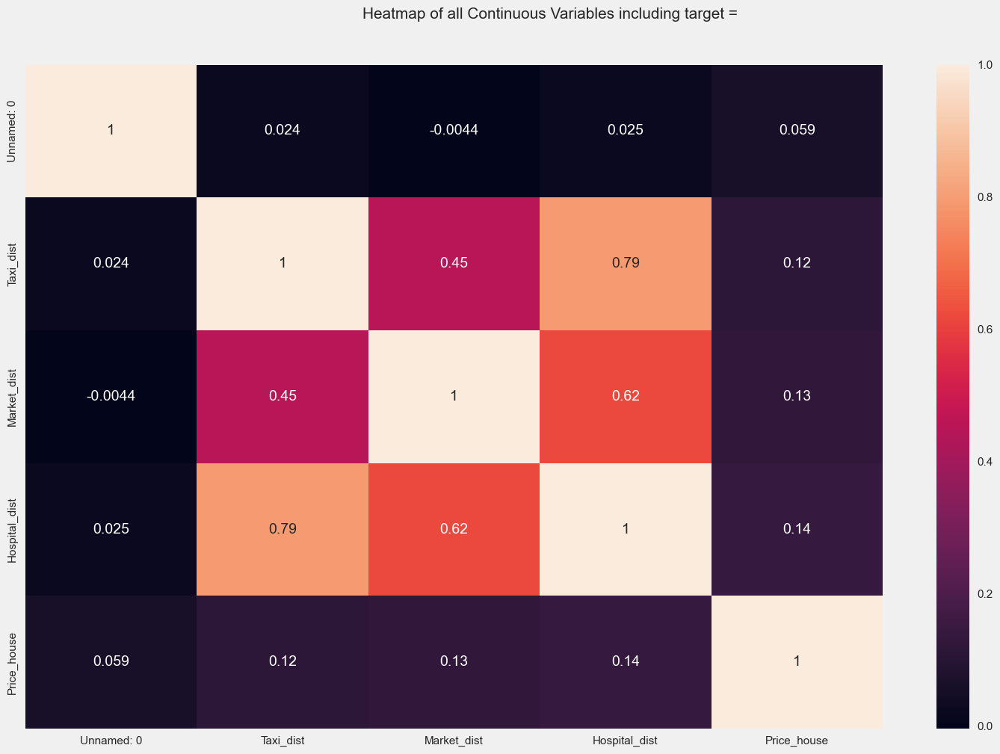

In [23]:
from autoviz.AutoViz_Class import AutoViz_Class   

AV = AutoViz_Class() #instantiaze the AV         

%matplotlib inline                               
filename = 'new_data.csv'
sep = ","
dft = AV.AutoViz(
    filename,
    sep=sep,
    depVar="",
    dfte=None,
    header=0,
    verbose=2,
    lowess=False,
    chart_format="svg",
    max_rows_analyzed=2000,
    max_cols_analyzed=20,
)

# Model the data

In [24]:
#Putting feature variable to X
x = np.array(df.drop(['Taxi_dist', 'Market_dist', 'Hospital_dist'], axis=1)).reshape(-1,1)

# Putting response variable to y
y = np.array(df['Price_house']).reshape(-1,1)

# splitting data into the training and testing test
x_train,x_test,y_train,y_test=train_test_split(x, y, test_size=0.30, random_state=500)

# Print the shape of each train and test data
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(652, 1)
(280, 1)
(652, 1)
(280, 1)


## LINEAR REGRESSION

In [25]:
# make lr as the LinearRegression()
lr = LinearRegression()
# fit the lr model
lr.fit(x_train, y_train)

LinearRegression()

In [26]:
# predict the test data
y_pred_lr = lr.predict(x_test)

### Find the Mean Absolute Error, RMSE, R^2, intercept_ and coef_

In [27]:
# Mean Absolute Error
print(f"Mean absolute error of test data is {mean_absolute_error(y_test, y_pred_lr)}")

# RMSE
print(f"MSE of test data is {mean_squared_error(y_test, y_pred_lr , squared=True)}")
print(f"RMSE of test data is {mean_squared_error(y_test, y_pred_lr , squared=False)}")

# R^2
print(f"R^2 of test data is {r2_score(y_test, y_pred_lr)}")

Mean absolute error of test data is 5.064066499471664e-10
MSE of test data is 5.500389950055926e-19
RMSE of test data is 7.416461386709922e-10
R^2 of test data is 1.0


In [28]:
# Independent term in the linear model
print(lr.intercept_)
print('*'*20)

# Estimated coefficients for the linear regression problem
print(lr.coef_)

[2.79396772e-09]
********************
[[1.]]


### Create a dataframe to have better visualize the actual and predicted values

In [29]:
# Use a dataframe to knoe the actual and predicted values
df = pd.DataFrame({'Actual': y_test.flatten(), 'Predicted': y_pred_lr.flatten()})
df

,Actual,Predicted
0,8193000.0,8193000.0
1,4999000.0,4999000.0
2,4109000.0,4109000.0
3,6409000.0,6409000.0
4,6044000.0,6044000.0
...,...,...
275,6372000.0,6372000.0
276,4972000.0,4972000.0
277,5666000.0,5666000.0
278,4347000.0,4347000.0


### Plot a barchart of Actual vs Predicted

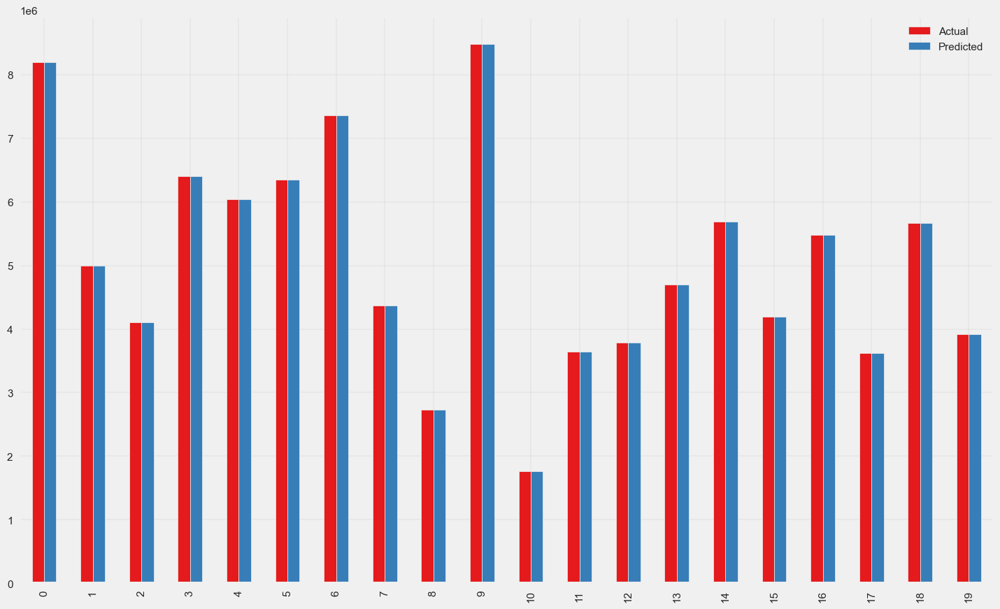

In [30]:
# Plot the first 20 data
df1 = df.head(20)
df1.plot(kind='bar',figsize=(16,10))

# Show the grid
plt.grid(which='major', linestyle='-', linewidth='0.1', color='grey')
plt.grid(which='minor', linestyle=':', linewidth='0.1', color='grey')

# Show the graph
plt.show()

### Model Evaluation for Linear Regression

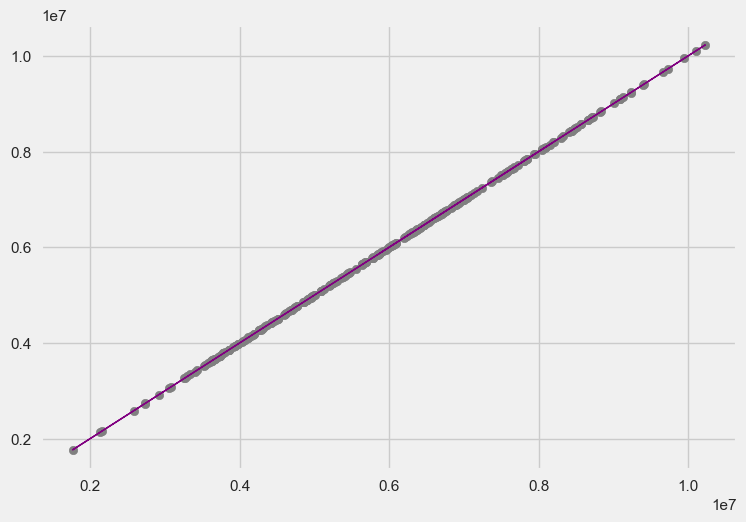

In [31]:
# Plot the scatter graph of x_test and y_test
plt.scatter(x_test, y_test,  color='grey')

# Plot a straight line
plt.plot(x_test, y_pred_lr, color='purple', linewidth=1)

# Plot heading 
plt.show()

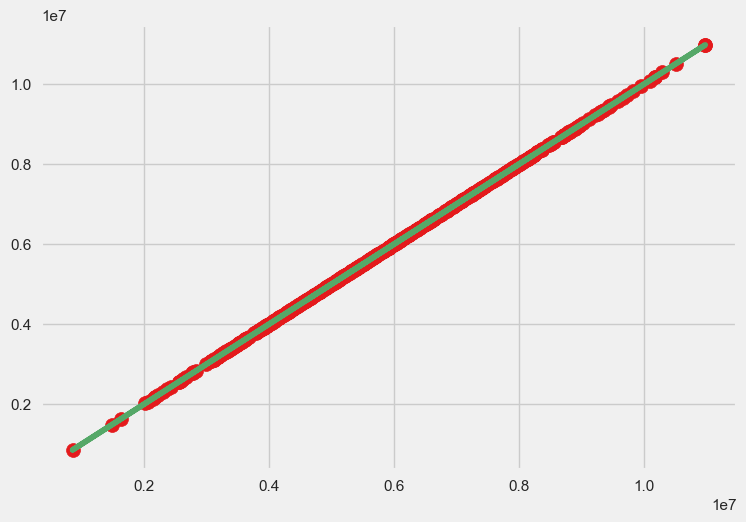

In [32]:
import operator

# Plot the scatter of x_train and y_train
plt.scatter(x_train, y_train, s=100)

# Sort the axis 
sort_axis = operator.itemgetter(0)
sorted_zip = sorted(zip(x_train, y_pred_lr), key=sort_axis)
x_test, y_pred_lr = zip(*sorted_zip)
plt.plot(x_train, y_train, color='g')
plt.show()

## POLYNOMIAL REGRESSION

In [33]:
# Make poly as PolynomialFeatures
poly = PolynomialFeatures(degree=4)
# transform the data
poly_df = poly.fit_transform(x_train)

#make lin as the linear regression
lin = LinearRegression()
# Fit the data
lin.fit(poly_df, y_train)

LinearRegression()

In [34]:
# Predicte the value 
y_pred_poly = lin.predict(poly_df)

### Find the Mean Absolute Error, RMSE, R^2

In [35]:
# Mean Absolute Error
print(f"Mean absolute error of test data is {mean_absolute_error(y_train, y_pred_poly)}")

# RMSE
print(f"MSE of test data is {mean_squared_error(y_train, y_pred_poly , squared=True)}")
print(f"RMSE of test data is {mean_squared_error(y_train, y_pred_poly , squared=False)}")

# R^2
print(f"R^2 of test data is {r2_score(y_train, y_pred_poly)}")

Mean absolute error of test data is 22239.95867534648
MSE of test data is 1391166893.3700883
RMSE of test data is 37298.34974057282
R^2 of test data is 0.9995344327485958


### Model Evaluation for Polynomial Regression

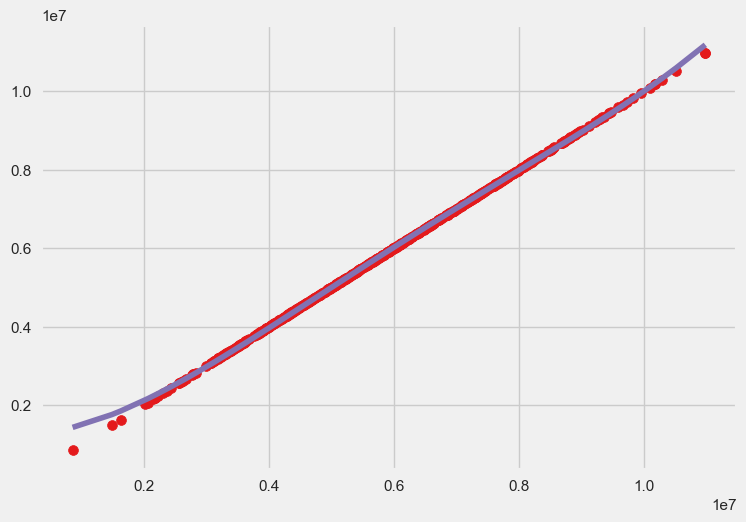

In [36]:
plt.scatter(x_train, y_train, s=50)
sort_axis = operator.itemgetter(0)
sorted_zip = sorted(zip(x_train, y_pred_poly), key=sort_axis)
x_train,y_pred_poly = zip(*sorted_zip)
plt.plot(x_train,y_pred_poly, color='m')
plt.show()

## III. Conclusions

### 9: Evaluate the results of the machine learning model

I have use two machine learning model to check which model which is suitable for this project

<b>Linear Regression</b>
 
- Mean absolute error of test data is 5.064066499471664e-10
- MSE of test data is 5.500389950055926e-19
- RMSE of test data is 7.416461386709922e-10
- R^2 of test data is 1.0

<b>polynomial Regression:</b>

- Mean absolute error of test data is 22239.95867534648
- MSE of test data is 1391166893.3700883
- RMSE of test data is 37298.34974057282
- R^2 of test data is 0.9995344327485958

Linear Regression perfrom better than polynoimal regression as the values of MAE, MSE and RMSE in linear regression is much lower than that of polynoimal regression. The r^2 score for linear regression is also higher than that of polynoimal regression.


### 10. Evaluation of the project and its results 

The predictions we generate may be especially relevant to the price price of the data house.

In general, a model is considered to be performing better if its MAE, MSE, and RMSE values are lower and its R2 value is greater. Since linear regression has substantially lower MAE, MSE, and RMSE values than polynoimal regression, it outperforms polynoimal regression in terms of performance. Additionally, compared to polynoimal regression, the r2 value for linear regression is also closer to 1. Moreover, the linear regression model has very minimal error and fits the graph well because the MAE, MSE, and RMSE values are extremely close to 0 and the r2 score is 1. The tested house price in the data is quite likely to correlate with the predictions we produce via linear regression.
 
According to myself, the solution is transferrable to other domain-specific areas because the concept behind computing the regression is essentially the same; the dataset remain as what it is. It will not change much if we follow the steps carefully and don't make any mistakes, hence it should be transferable to other domain-specific areas.
 
I genuinely believe that the project can be reproduced using various programming languages, environment settings, ML libraries, and ML algorithms. The algorithm for each regression, each MAE, MSE, RMSE, and r2 is the same, even though different languages each have their own distinct characteristics. This is because formula used to calculate the data in each regression is identical, as is the basic notion or core concept. It should be possible to replicate it using different programming languages as a result. 
 
 
The benefits of different methods include the opportunity to learn additional programming languages. C++ modules are frequently used in conjunction with Python to enhance Python and make up for some of its less advantageous features. Additionally, low-level capabilities result from invoking C++ from Python. You could use C++'s accelerator modules to resolve Python's performance difficulties. As a result, C++-written code will perform at a better level. In general, integrating C++ and Python for your applications implies combining speed and simplicity.
They are well-known, high-level, platform-independent languages that are frequently used for backend development. Both of them are compatible with virtual machines, enable object-oriented programming, and compile to bytecode.
 
The drawbacks include the time required to learn C++ since Python programmers must study it differently because C++ is more difficult and requires more thought and much research.